In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity

In [2]:
# load the movie rating data into a dataframe
rating_header = ["user_id", "item_id", "rating", "timestamp"]
rating = pd.read_csv("./ml-100k/u1.base", sep = '\t', header = None, names=rating_header)

In [3]:
rating.head()

,user_id,item_id,rating,timestamp
0,1,1,5,874965758
1,1,2,3,876893171
2,1,3,4,878542960
3,1,4,3,876893119
4,1,5,3,889751712


In [4]:
rating.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80000 entries, 0 to 79999
Data columns (total 4 columns):
user_id      80000 non-null int64
item_id      80000 non-null int64
rating       80000 non-null int64
timestamp    80000 non-null int64
dtypes: int64(4)
memory usage: 2.4 MB


In [5]:
# load the user data into a dataframe
user_header = ["user_id", "age", "gender", "occupation", "zip_code"]
users = pd.read_csv("./ml-100k/u.user", sep = '|', header = None, names=user_header)

In [6]:
users.head()

,user_id,age,gender,occupation,zip_code
0,1,24,M,technician,85711
1,2,53,F,other,94043
2,3,23,M,writer,32067
3,4,24,M,technician,43537
4,5,33,F,other,15213


In [7]:
users.loc[users['zip_code'] == 'T8H1N']

,user_id,age,gender,occupation,zip_code
73,74,39,M,scientist,T8H1N
633,634,39,M,engineer,T8H1N


In [8]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 943 entries, 0 to 942
Data columns (total 5 columns):
user_id       943 non-null int64
age           943 non-null int64
gender        943 non-null object
occupation    943 non-null object
zip_code      943 non-null object
dtypes: int64(2), object(3)
memory usage: 36.9+ KB


In [9]:
# load movie data into a dataframe
movie_header = ["item_id", "title", "release_date", "video_release_date", "IMDb_URL",
         "unknown", "Action", "Adventure", "Animation","Children's", "Comedy", "Crime",
         "Documentary", "Drama", "Fantasy", "Film-Noir", "Horror", "Musical", "Mystery", 
         "Romance", "Sci-Fi", "Thriller", "War", "Western"]
movies = pd.read_csv("./ml-100k/u.item", sep = '|', header = None, encoding = 'latin1', names = movie_header)

In [10]:
# remove the video release date (no values)
movies = movies.drop(columns=['video_release_date'])
movies.head()


,item_id,title,release_date,IMDb_URL,unknown,Action,Adventure,Animation,Children's,Comedy,...,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,1,Toy Story (1995),01-Jan-1995,http://us.imdb.com/M/title-exact?Toy%20Story%2...,0,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1,2,GoldenEye (1995),01-Jan-1995,http://us.imdb.com/M/title-exact?GoldenEye%20(...,0,1,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
2,3,Four Rooms (1995),01-Jan-1995,http://us.imdb.com/M/title-exact?Four%20Rooms%...,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,4,Get Shorty (1995),01-Jan-1995,http://us.imdb.com/M/title-exact?Get%20Shorty%...,0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,5,Copycat (1995),01-Jan-1995,http://us.imdb.com/M/title-exact?Copycat%20(1995),0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [11]:
print(movies)

      item_id                                              title release_date  \
0           1                                   Toy Story (1995)  01-Jan-1995   
1           2                                   GoldenEye (1995)  01-Jan-1995   
2           3                                  Four Rooms (1995)  01-Jan-1995   
3           4                                  Get Shorty (1995)  01-Jan-1995   
4           5                                     Copycat (1995)  01-Jan-1995   
5           6  Shanghai Triad (Yao a yao yao dao waipo qiao) ...  01-Jan-1995   
6           7                              Twelve Monkeys (1995)  01-Jan-1995   
7           8                                        Babe (1995)  01-Jan-1995   
8           9                            Dead Man Walking (1995)  01-Jan-1995   
9          10                                 Richard III (1995)  22-Jan-1996   
10         11                               Seven (Se7en) (1995)  01-Jan-1995   
11         12               

In [12]:

movies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1682 entries, 0 to 1681
Data columns (total 23 columns):
item_id         1682 non-null int64
title           1682 non-null object
release_date    1681 non-null object
IMDb_URL        1679 non-null object
unknown         1682 non-null int64
Action          1682 non-null int64
Adventure       1682 non-null int64
Animation       1682 non-null int64
Children's      1682 non-null int64
Comedy          1682 non-null int64
Crime           1682 non-null int64
Documentary     1682 non-null int64
Drama           1682 non-null int64
Fantasy         1682 non-null int64
Film-Noir       1682 non-null int64
Horror          1682 non-null int64
Musical         1682 non-null int64
Mystery         1682 non-null int64
Romance         1682 non-null int64
Sci-Fi          1682 non-null int64
Thriller        1682 non-null int64
War             1682 non-null int64
Western         1682 non-null int64
dtypes: int64(20), object(3)
memory usage: 302.3+ KB


# Data Transformation and Combination
Some ML approaches expect the data set with numerical values only, the following codes show how to convert catergorical data into numbers

In [13]:
# transfrom the users dataframe with numerical values (excluding zip_code)
users_num = users.copy()
users_num["gender"].replace(['F', 'M'],[0, 1], inplace=True) # replace F and M with 0 and 1, respectively

In [14]:
occupation = pd.read_csv("./ml-100k/u.occupation", header = None)
occupation_list = occupation.values
users_num["occupation"].replace(occupation_list,list(range(0, len(occupation_list))), inplace=True)
users_num.head()

,user_id,age,gender,occupation,zip_code
0,1,24,1,19,85711
1,2,53,0,13,94043
2,3,23,1,20,32067
3,4,24,1,19,43537
4,5,33,0,13,15213


In [15]:
# data aggregation
average_rating = rating[["item_id", "rating"]].groupby("item_id", as_index=False).mean()  # average rating per movie
average_rating.sort_values("rating",ascending=False).head()

,item_id,rating
1181,1189,5.0
1620,1653,5.0
1566,1599,5.0
1479,1500,5.0
1449,1467,5.0


In [16]:
# merge two dataframes (average_rating and movies)
pd.merge(average_rating, movies[["item_id", "title"]])

,item_id,rating,title
0,1,3.892950,Toy Story (1995)
1,2,3.180952,GoldenEye (1995)
2,3,3.000000,Four Rooms (1995)
3,4,3.526316,Get Shorty (1995)
4,5,3.304348,Copycat (1995)
5,6,3.400000,Shanghai Triad (Yao a yao yao dao waipo qiao) ...
6,7,3.798046,Twelve Monkeys (1995)
7,8,3.994220,Babe (1995)
8,9,3.833333,Dead Man Walking (1995)
9,10,3.876712,Richard III (1995)


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f176ce95810>]],
      dtype=object)

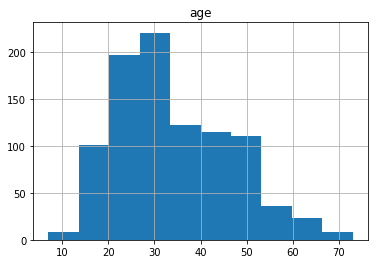

In [17]:
# age intervals distrubution
users.hist(column="age")
#users["age_category"] = pd.cut(users["age"], bins = [0, 10, 20, 30, 40, 50, 60, 70, 80], labels=[5, 15, 25, 35, 45, 55, 65, 75])
#users["age_category"].hist()

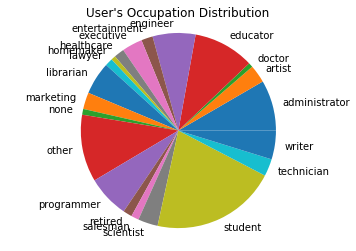

In [18]:
# occupation distrubution
occupation_count = users[["user_id", "occupation"]].groupby("occupation", as_index=False).size()  # count the numbers
plt.pie(occupation_count, labels=occupation_count.index.tolist())
plt.title("User's Occupation Distribution")
plt.axis("equal")
plt.show()

<BarContainer object of 2 artists>

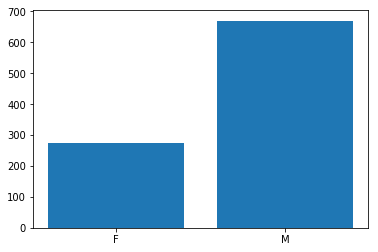

In [19]:
gender_count = users[["user_id", "gender"]].groupby("gender", as_index=False).size()
# print(gender_count.)
plt.bar(gender_count.index.tolist(),gender_count)

In [20]:

# Clustering the movies by genre
genre = pd.read_csv("./ml-100k/u.genre", sep = '|', header = None)
genre_list = genre[0].values
movie_set_genre = movies[genre_list]

In [21]:
from sklearn.cluster import KMeans
k = 50
kmeans = KMeans(n_clusters=k)
kmeans.fit_predict(movie_set_genre)


array([ 5, 32, 18, ..., 10,  7,  4], dtype=int32)

In [22]:

kmeans.inertia_

299.2948527085533

In [23]:
# compute the similarity between two movies
import scipy.spatial.distance as sp_dist
genre_array = movie_set_genre.to_numpy()

x = genre_array[0]
y = genre_array[1]
print(sp_dist.cosine(x,y))
print(sp_dist.euclidean(x,y))
print(sp_dist.jaccard(x,y))

1.0
2.449489742783178
1.0


In [24]:
# compute the matrix of all pairwise distances of movies
import sklearn.metrics as metrics

distance_matrix = metrics.pairwise_distances(genre_array,metric = 'jaccard') # ‘cosine’, ‘euclidean’, etc
print(distance_matrix)

[[0.         1.         1.         ... 1.         0.66666667 1.        ]
 [1.         0.         0.66666667 ... 1.         1.         1.        ]
 [1.         0.66666667 0.         ... 1.         1.         1.        ]
 ...
 [1.         1.         1.         ... 0.         1.         0.5       ]
 [0.66666667 1.         1.         ... 1.         0.         1.        ]
 [1.         1.         1.         ... 0.5        1.         0.        ]]


/home/hui/anaconda2/lib/python2.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype int64 was converted to bool by check_pairwise_arrays.
  warnings.warn(msg, DataConversionWarning)


In [25]:
cosine_sim = cosine_similarity(distance_matrix)
print(cosine_sim)
# similarity_df  =  pd.DataFrame(cosine_sim) 
# import numpy as np
# import pandas as pd
# from sklearn.metrics.pairwise import cosine_similarity

# df = pd.DataFrame(np.random.normal(0, 1, (10, 10)))
# similarity_df = pd.DataFrame(cosine_similarity(df))
# print(similarity_df)

[[1.         0.9539797  0.95282255 ... 0.90418282 0.95533448 0.80506676]
 [0.9539797  1.         0.98137257 ... 0.90180492 0.87688038 0.80736938]
 [0.95282255 0.98137257 1.         ... 0.90745293 0.88014537 0.81732405]
 ...
 [0.90418282 0.90180492 0.90745293 ... 1.         0.81899519 0.93656432]
 [0.95533448 0.87688038 0.88014537 ... 0.81899519 1.         0.71058035]
 [0.80506676 0.80736938 0.81732405 ... 0.93656432 0.71058035 1.        ]]


In [26]:
rating_u1 = pd.read_csv("./ml-100k/u1.test", sep = '\t', header = None, names=rating_header)
rating_u1.head()
rating_u1.drop(columns=['timestamp'])

df = rating_u1[rating_u1['user_id']==1]

u1_rating = rating.copy()
print(u1_rating[u1_rating['user_id']==1])
df_u1 = u1_rating[u1_rating['user_id']==1]
# print(df)


     user_id  item_id  rating  timestamp
0          1        1       5  874965758
1          1        2       3  876893171
2          1        3       4  878542960
3          1        4       3  876893119
4          1        5       3  889751712
5          1        7       4  875071561
6          1        8       1  875072484
7          1        9       5  878543541
8          1       11       2  875072262
9          1       13       5  875071805
10         1       15       5  875071608
11         1       16       5  878543541
12         1       18       4  887432020
13         1       19       5  875071515
14         1       21       1  878542772
15         1       22       4  875072404
16         1       25       4  875071805
17         1       26       3  875072442
18         1       28       4  875072173
19         1       29       1  878542869
20         1       30       3  878542515
21         1       32       5  888732909
22         1       34       2  878542869
23         1    

In [27]:
 print(df_u1['item_id'])

0        1
1        2
2        3
3        4
4        5
5        7
6        8
7        9
8       11
9       13
10      15
11      16
12      18
13      19
14      21
15      22
16      25
17      26
18      28
19      29
20      30
21      32
22      34
23      35
24      37
25      38
26      40
27      41
28      42
29      43
      ... 
105    199
106    203
107    204
108    205
109    207
110    211
111    216
112    217
113    220
114    223
115    231
116    234
117    237
118    238
119    239
120    240
121    244
122    245
123    246
124    247
125    249
126    251
127    256
128    257
129    261
130    263
131    268
132    269
133    270
134    271
Name: item_id, Length: 135, dtype: int64


In [36]:


for itemId in df['item_id']:
    predict_sum =0.0
#     sim_sum = 0
    for count in  df_u1['item_id']:
        
        
        similarity = cosine_sim[itemId-1][count-1]
#         df_u1 = df_u1[df_u1['item_id']==count].astype({'rating':'float'})
#         print(df.dtypes)
        
        
        rating = df_u1[df_u1['item_id']==count]['rating']
#         rating = pd.to_numeric(rating,errors='coerce')
        
#         cosine_sim[itemId-1][count-1]
#         print (cosine_sim[itemId-1][count-1])

        predict = similarity*rating
    
        print(predict)
        print(similarity)
        print("0000:",predict)
        predict_sum = predict_sum +predict
        print('predict_sum',predict_sum)
#         print ('item : ',itemId ,'count:',count,'=', rating , predict)
    
#         predict_sum =predict+predict_sum
        
#         sim_sum +=similarity
#         print("after:",predict_sum)
        print('end')
        
    
#     print(sim_sum)
    print(predict_sum)


#         print(itemId)
#         print (df_u1[df_u1['item_id']==count]['rating'])
#         print (df_u1[df_u1['item_id']==count])

0    4.025334
Name: rating, dtype: float64
0.8050667586737685
('0000:', 0    4.025334
Name: rating, dtype: float64)
('predict_sum', 0    4.025334
Name: rating, dtype: float64)
end
1    2.422108
Name: rating, dtype: float64
0.8073693836362402
('0000:', 1    2.422108
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
Name: rating, dtype: float64)
end
2    3.269296
Name: rating, dtype: float64
0.8173240549293744
('0000:', 2    3.269296
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
Name: rating, dtype: float64)
end
3    2.658716
Name: rating, dtype: float64
0.8862387258328854
('0000:', 3    2.658716
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
Name: rating, dtype: float64)
end
4    2.724911
Name: rating, dtype: float64
0.9083038299711805
('0000:', 4    2.724911
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
Name: rating, dtype: float64)
end
5    3.806659
Name: rating, dtype: float64
0

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
95   NaN
96   NaN
97   NaN
98   NaN
99   NaN
Name: rating, Length: 100, dtype: float64)
end
100    4.0
Name: rating, dtype: float64
1.0000000000000018
('0000:', 100    4.0
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26

64    3.624341
Name: rating, dtype: float64
0.9060852575850573
('0000:', 64    3.624341
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
Name: rating, Length: 65, dtype: float64)
end
65    4.95198
Name: rating, dtype: float64
0.9903960174131518
('0000:', 65    4.95198
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15  

19    0.974431
Name: rating, dtype: float64
0.9744306986253564
('0000:', 19    0.974431
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
Name: rating, dtype: float64)
end
20    2.477912
Name: rating, dtype: float64
0.825970786798831
('0000:', 20    2.477912
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
Name: rating, dtype: float64)
end
21    4.845189
Name: rating, dtype: float64
0.9690378050594384
('0000:', 21    4.845189
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN


('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
Name: rating, Length: 112, dtype: float64)
end
112    2.90994
Name: rating, dtype: float64
0.9699801164710123
('0000:', 112    2.90994
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19 

0.9365643217563102
('0000:', 72    4.682822
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
Name: rating, Length: 73, dtype: float64)
end
73    0.883823
Name: rating, dtype: float64
0.8838232033634426
('0000:', 73    0.883823
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
2

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
Name: rating, dtype: float64)
end
31    3.225145
Name: rating, dtype: float64
0.8062861915263254
('0000:', 31    3.225145
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
Name: rating, dtype: float64)
end
32    4.858419
Name: rating, dtype: float64
0.9716838248754698
('0000:', 32    4.858419
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN


0.9619542464329894
('0000:', 119    3.847817
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
Name: rating, Length: 120, dtype: float64)
end
120    2.930864
Name: rating, dtype: float64
0.976954645252925
('0000:', 120    2.930864
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    N

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
Name: rating, Length: 74, dtype: float64)
end
74    2.65147
Name: rating, dtype: float64
0.8838232033634426
('0000:', 74    2.65147
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
Name: rating, dtype: float64)
end
33    4.662651
Name: rating, dtype: float64
0.9325302832466649
('0000:', 33    4.662651
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
Name: rating, dtype: float64)
end
34    3.75263
Name: rating, dtype: float64
0.9381575818203033
('0000:', 34    3.75263
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5 

Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
Name: rating, Length: 125, dtype: float64)
end
125    3.279567
Name: rating, dtype: float64
0.8198916881784564
('0000:', 125    3.279567
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
Name: rating, Length: 92, dtype: float64)
end
92    4.910696
Name: rating, dtype: float64
0.9821391808163431
('0000:', 92    4.910696
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

Name: rating, dtype: float64)
end
51    1.883864
Name: rating, dtype: float64
0.941931868589167
('0000:', 51    1.883864
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
Name: rating, dtype: float64)
end
52    3.850515
Name: rating, dtype: float64
0.9626287066593523
('0000:', 52    3.850515
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN

Name: rating, dtype: float64
0.9825509723819343
('0000:', 5    3.930204
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
Name: rating, dtype: float64)
end
6    0.961789
Name: rating, dtype: float64
0.9617891053622482
('0000:', 6    0.961789
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
Name: rating, dtype: float64)
end
7    4.570022
Name: rating, dtype: float64
0.9140044326652437
('0000:', 7    4.570022
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
Name: rating, dtype: float64)
end
8    1.94523
Name: rating, dtype: float64
0.9726150390497527
('0000:', 8    1.94523
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
Name: rating, dtype: float64)
end
9    4.288424
Name: rating, dtype: float64
0.8576847436361296
('0000:', 9    4.288424
Name: rating, dtype: float

('0000:', 104    4.857094
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
75    NaN
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
Name: rating, Length: 105, dtype: float64)
end
105    3.946624
Name: rating, dtype: float64
0.9866559359779202
('0000:', 105    3.946624
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13   

Name: rating, Length: 63, dtype: float64)
end
63    2.644505
Name: rating, dtype: float64
0.8815018112254955
('0000:', 63    2.644505
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
Name: rating, Length: 64, dtype: float64)
end
64    3.774515
Name: rating, dtype: float64
0.9436286955186307
('0000:', 64    3.774515
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
1

17    2.456986
Name: rating, dtype: float64
0.818995192291414
('0000:', 17    2.456986
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
Name: rating, dtype: float64)
end
18    3.786394
Name: rating, dtype: float64
0.946598575936981
('0000:', 18    3.786394
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
Name: rating, dtype: float64)
end
19    0.905287
Name: rating, dtype: float64
0.9052867806046986
('0000:', 19    0.905287
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
Name: rating, dtype

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
Name: rating, Length: 108, dtype: float64)
end
108    2.918104
Name: rating, dtype: float64
0.972701489148037
('0000:', 108    2.918104
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
Name: rating, Length: 73, dtype: float64)
end
73    0.951181
Name: rating, dtype: float64
0.9511809031759301
('0000:', 73    0.951181
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
Name: rating, dtype: float64)
end
31    3.75263
Name: rating, dtype: float64
0.9381575818203033
('0000:', 31    3.75263
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
Name: rating, dtype: float64)
end
32    4.666257
Name: rating, dtype: float64
0.933251396052077
('0000:', 32    4.666257
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9  

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
Name: rating, Length: 122, dtype: float64)
end
122    1.956829
Name: rating, dtype: float64
0.9784145798004487
('0000:', 122    1.956829
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
Name: rating, Length: 89, dtype: float64)
end
89    4.615501
Name: rating, dtype: float64
0.9231001470068805
('0000:', 89    4.615501
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

0.972316727569996
('0000:', 51    1.944633
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
Name: rating, dtype: float64)
end
52    3.860383
Name: rating, dtype: float64
0.9650957871403423
('0000:', 52    3.860383
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   

Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
Name: rating, dtype: float64)
end
4    2.927352
Name: rating, dtype: float64
0.9757839080707006
('0000:', 4    2.927352
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
Name: rating, dtype: float64)
end
5    3.919284
Name: rating, dtype: float64
0.9798211131675154
('0000:', 5    3.919284
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
Name: rating, dtype: float64)
end
6    0.970502
Name: rating, dtype: float64
0.9705018606505671
('0000:', 6    0.970502
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
Name: rating, dtype: float64)
end
7    4.508547
Name: rating, dtype: float64
0.9017093544685053
('0000:', 7    4.508547
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
Name: rating, dtype: float64)
end
8    1.925791
Na

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
73    NaN
74    NaN
75    NaN
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
Name: rating, Length: 103, dtype: float64)
end
103    4.905202
Name: rating, dtype: float64
0.981040385722839
('0000:', 103    4.905202
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
Name: rating, Length: 65, dtype: float64)
end
65    4.627152
Name: rating, dtype: float64
0.925430399716682
('0000:', 65    4.627152
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28  

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
Name: rating, dtype: float64)
end
24    1.79357
Name: rating, dtype: float64
0.8967848038389594
('0000:', 24    1.79357
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
Name: rating, dtype: float64)
end
25    2.918667
Name: rating, dtype: float64
0.9728889676212328
('0000:', 25    2.918667
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
Name: rating, Length: 118, dtype: float64)
end
118    3.373034
Name: rating, dtype: float64
0.8432584138472312
('0000:', 118    3.373034
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
Name: rating, Length: 87, dtype: float64)
end
87    4.744246
Name: rating, dtype: float64
0.9488491994709756
('0000:', 87    4.744246
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

0.8478954889673114
('0000:', 49    4.239477
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
Name: rating, dtype: float64)
end
50    4.53235
Name: rating, dtype: float64
0.9064699593280228
('0000:', 50    4.53235
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   N

Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
132   NaN
133   NaN
134   NaN
Name: rating, Length: 135, dtype: float64)
end
0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    N

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
Name: rating, Length: 95, dtype: float64)
end
95    2.53397
Name: rating, dtype: float64
0.8446567753554584
('0000:', 95    2.53397
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
Name: rating, dtype: float64)
end
58    0.986906
Name: rating, dtype: float64
0.9869061366102312
('0000:', 58    0.986906
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   N

Name: rating, dtype: float64
1.0000000000000018
('0000:', 10    5.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
Name: rating, dtype: float64)
end
11    3.793199
Name: rating, dtype: float64
0.7586397805049142
('0000:', 11    3.793199
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
Name: rating, dtype: float64)
end
12    4.0
Name: rating, dtype: float64
1.0000000000000018
('0000:', 12    4.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
Name: rating, dtype: float64)
end
13    5.0
Name: rating, dtype: float64
1.0000000000000018
('0000:', 13    5.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    N

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
75    NaN
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
Name: rating, Length: 105, dtype: float64)
end
105    3.808118
Name: rating, dtype: float64
0.9520296181544674
('0000:', 105    3.808118
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
Name: rating, Length: 70, dtype: float64)
end
70    3.743134
Name: rating, dtype: float64
0.9357834795664828
('0000:', 70    3.743134
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

Name: rating, dtype: float64
0.8198916881784564
('0000:', 29    3.279567
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
Name: rating, dtype: float64)
end
30    4.615501
Name: rating, dtype: float64
0.9231001470068805
('0000:', 30    4.615501
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
Name: rating, dtype: float64)
end
31    2.842321
Name: rating, dtype: float64
0.7105803487918727
('0000:', 31    2.842321
Name: rating, dtype: float64)
('predict_su

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
Name: rating, Length: 119, dtype: float64)
end
119    3.47133
Name: rating, dtype: float64
0.8678325719314459
('0000:', 119    3.47133
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19 

0.9530818729490133
('0000:', 83    3.812327
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
Name: rating, Length: 84, dtype: float64)
end
84    2.859365
Name: rating, dtype: float64
0.9531217538003111
('0000:', 84    2.859365
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
2

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
Name: rating, dtype: float64)
end
48    4.0
Name: rating, dtype: float64
1.0000000000000002
('0000:', 48    4.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   Na

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
132   NaN
133   NaN
Name: rating, Length: 134, dtype: float64)
end
134    1.862765
Name: rating, dtype: float64
0.9313824857269513
('0000:', 134    1.862765
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
95   NaN
96   NaN
97   NaN
98   NaN
99   NaN
Name: rating, Length: 100, dtype: float64)
end
100    3.260762
Name: rating, dtype: float64
0.8151906148123486
('0000:', 100    3.260762
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25

Name: rating, dtype: float64
0.9284685074711478
('0000:', 65    4.642343
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
Name: rating, Length: 66, dtype: float64)
end
66    1.603584
Name: rating, dtype: float64
0.8017919238438248
('0000:', 66    1.603584
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN

Name: rating, dtype: float64
0.8862387258328854
('0000:', 24    1.772477
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
Name: rating, dtype: float64)
end
25    2.851874
Name: rating, dtype: float64
0.9506247500950249
('0000:', 25    2.851874
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
Name: rating, dtype: float64)
end
26    2.777512
Name: rating, dtype: float64
0.925837364566022
('0000:', 26    2.777512
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    N

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
Name: rating, Length: 116, dtype: float64)
end
116    3.849902
Name: rating, dtype: float64
0.96247551651267
('0000:', 116    3.849902
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
Name: rating, Length: 78, dtype: float64)
end
78    3.795397
Name: rating, dtype: float64
0.9488491994709756
('0000:', 78    3.795397
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
Name: rating, dtype: float64)
end
42    2.931429
Name: rating, dtype: float64
0.9771431144056506
('0000:', 42    2.931429
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
Name: rating, dtype: float64)
end
43    3.847269
Na

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
132   NaN
Name: rating, Length: 133, dtype: float64)
end
133    4.893094
Name: rating, dtype: float64
0.9786188664983111
('0000:', 133    4.893094
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
95   NaN
96   NaN
97   NaN
98   NaN
99   NaN
Name: rating, Length: 100, dtype: float64)
end
100    3.204488
Name: rating, dtype: float64
0.8011220690588198
('0000:', 100    3.204488
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25

Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
Name: rating, Length: 66, dtype: float64)
end
66    1.51728
Name: rating, dtype: float64
0.7586397805049142
('0000:', 66    1.51728
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25

end
23    0.965097
Name: rating, dtype: float64
0.9650965210327804
('0000:', 23    0.965097
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
Name: rating, dtype: float64)
end
24    1.635846
Name: rating, dtype: float64
0.8179231178234266
('0000:', 24    1.635846
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
Name: rating, dtype: float64)
end
25    2.942424
Name: rating, dtype: float64
0.9808079062806954
('0000:', 25    2.942424
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9   

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
Name: rating, Length: 113, dtype: float64)
end
113    2.775725
Name: rating, dtype: float64
0.9252416987828838
('0000:', 113    2.775725
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
Name: rating, Length: 80, dtype: float64)
end
80    1.673666
Name: rating, dtype: float64
0.8368332145758249
('0000:', 80    1.673666
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('0000:', 41    3.526007
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
Name: rating, dtype: float64)
end
42    2.717157
Name: rating, dtype: float64
0.9057188988548025
('0000:', 42    2.717157
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
Name: rating, Length: 132, dtype: float64)
end
132    5.0
Name: rating, dtype: float64
1.0
('0000:', 132    5.0
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
95   NaN
Name: rating, Length: 96, dtype: float64)
end
96    4.129065
Name: rating, dtype: float64
0.8258129725888436
('0000:', 96    4.129065
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
Name: rating, dtype: float64)
end
60    4.786341
Name: rating, dtype: float64
0.9572682298233061
('0000:', 60    4.786341
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      

Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
Name: rating, dtype: float64)
end
15    3.775013
Name: rating, dtype: float64
0.9437532904583128
('0000:', 15    3.775013
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
Name: rating, dtype: float64)
end
16    3.825144
Name: rating, dtype: float64
0.9562860315965824
('0000:', 16    3.825144
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
Name: rating, dtype: float64)
end
17    2.868858
Name: rating, dtype: float64
0.9562860315965824
('0000:', 17    2.868858
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN


Name: rating, Length: 108, dtype: float64)
end
108    2.770326
Name: rating, dtype: float64
0.9234419124808647
('0000:', 108    2.770326
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
Name: rating, Length: 109, dtype: float64)
end
109    4.688205
Name: rating, dtype: float64
0.9376410947325291
('0000:', 109    4.688205
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2   

0.9818170702064511
('0000:', 75    2.945451
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
Name: rating, Length: 76, dtype: float64)
end
76    1.959823
Name: rating, dtype: float64
0.9799114638110911
('0000:', 76    1.959823
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
2

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
Name: rating, dtype: float64)
end
33    4.927393
Name: rating, dtype: float64
0.9854786785416388
('0000:', 33    4.927393
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
Name: rating, dtype: float64)
end
34    3.240277
Name: rating, dtype: float64
0.8100691893961894
('0000:', 34    3.240277
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN


('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
Name: rating, Length: 122, dtype: float64)
end
122    1.962518
Name: rating, dtype: float64
0.9812590440168273
('0000:', 122    1.962518
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

82    2.618252
Name: rating, dtype: float64
0.8727507745058878
('0000:', 82    2.618252
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
Name: rating, Length: 83, dtype: float64)
end
83    3.853513
Name: rating, dtype: float64
0.9633783397091217
('0000:', 83    3.853513
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15

Name: rating, dtype: float64
0.933251396052077
('0000:', 43    3.733006
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
Name: rating, dtype: float64)
end
44    4.0
Name: rating, dtype: float64
0.999999999999996
('0000:', 44    4.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   

0.912667603536047
('0000:', 128    3.65067
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
Name: rating, Length: 129, dtype: float64)
end
129    0.888114
Name: rating, dtype: float64
0.8881140357258841
('0000:', 129    0.888114
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    Na

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
Name: rating, Length: 80, dtype: float64)
end
80    1.816608
Name: rating, dtype: float64
0.9083038299711805
('0000:', 80    1.816608
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
Name: rating, dtype: float64)
end
46    2.824519
Name: rating, dtype: float64
0.9415063072160164
('0000:', 46    2.824519
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   N

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
132   NaN
133   NaN
Name: rating, Length: 134, dtype: float64)
end
134    1.960156
Name: rating, dtype: float64
0.9800780489700277
('0000:', 134    1.960156
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
71    NaN
72    NaN
73    NaN
74    NaN
75    NaN
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
Name: rating, Length: 101, dtype: float64)
end
101    3.85481
Name: rating, dtype: float64
0.9637024598036236
('0000:', 101    3.85481
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
Name: rating, Length: 69, dtype: float64)
end
69    3.436802
Name: rating, dtype: float64
0.8592005390747375
('0000:', 69    3.436802
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

Name: rating, dtype: float64
0.7105803487918727
('0000:', 28    3.552902
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
Name: rating, dtype: float64)
end
29    3.75263
Name: rating, dtype: float64
0.9381575818203033
('0000:', 29    3.75263
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
Name: rating, dtype: float64)
end
30    4.53235
Name: rating, dtype: float64
0.9064699593280228
('0000:', 30    4.53235
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN


('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
Name: rating, Length: 121, dtype: float64)
end
121    1.79357
Name: rating, dtype: float64
0.8967848038389594
('0000:', 121    1.79357
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
Name: rating, Length: 88, dtype: float64)
end
88    2.0
Name: rating, dtype: float64
1.0
('0000:', 88    2.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
5

Name: rating, dtype: float64
0.9894680526193712
('0000:', 53    2.968404
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
Name: rating, dtype: float64)
end
54    1.974115
Name: rating, dtype: float64
0.9870576648411221
('0000:', 54    1.974115
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25

end
9    3.552902
Name: rating, dtype: float64
0.7105803487918727
('0000:', 9    3.552902
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
9   NaN
Name: rating, dtype: float64)
end
10    5.0
Name: rating, dtype: float64
1.0000000000000018
('0000:', 10    5.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
Name: rating, dtype: float64)
end
11    3.793199
Name: rating, dtype: float64
0.7586397805049142
('0000:', 11    3.793199
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
Name: rating, dtype: float64)
end
12    4.0
Name: rating, dtype: float64
1.0000000000000018
('0000:', 12    4.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10 

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
Name: rating, Length: 107, dtype: float64)
end
107    3.942953
Name: rating, dtype: float64
0.788590512226633
('0000:', 107    3.942953
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
Name: rating, Length: 75, dtype: float64)
end
75    2.975445
Name: rating, dtype: float64
0.991814965399242
('0000:', 75    2.975445
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28  

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
Name: rating, dtype: float64)
end
37    3.229478
Name: rating, dtype: float64
0.8073693836362402
('0000:', 37    3.229478
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
Name: rating, dtype: float64)
end
38    4.036847
Name: rating, dtype: float64
0.8073693836362402
('0000:', 38    4.036847
Name: rating, dtype

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
Name: rating, Length: 129, dtype: float64)
end
129    0.937327
Name: rating, dtype: float64
0.937326902378865
('0000:', 129    0.937327
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
Name: rating, Length: 94, dtype: float64)
end
94    4.036847
Name: rating, dtype: float64
0.8073693836362402
('0000:', 94    4.036847
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
Name: rating, dtype: float64)
end
50    4.72332
Name: rating, dtype: float64
0.9446640782525308
('0000:', 50    4.72332
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN

0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
132   NaN
133   NaN
134   NaN
Name: rating, Length: 135, dtype: float64
0    4.840032
Name: rating, dtype: float64
0.9680064958716976
('0000:', 0    4.840032
Name: rating, dtype: float64)
('predict_sum', 0    4.840032
Name: rating, dtype: float64)
end
1    2.959128
Name: rating, dtype: float64
0.9863761090632077
('0000:', 1    2.959128
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
Name: rating, dtype:

0.973334863602151
('0000:', 98    3.893339
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
95   NaN
96   NaN
97   NaN
98   NaN
Name: rating, Length: 99, dtype: float64)
end
99    4.734079
Name: rating, dtype: float64
0.9468157419016943
('0000:', 99    4.734079
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20

0.8867550079348836
('0000:', 64    3.54702
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
Name: rating, Length: 65, dtype: float64)
end
65    4.874997
Name: rating, dtype: float64
0.9749993310914173
('0000:', 65    4.874997
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
Name: rating, dtype: float64)
end
24    1.605069
Name: rating, dtype: float64
0.8025344298587705
('0000:', 24    1.605069
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
Name: rating, dtype: float64)
end
25    2.956818
Name: rating, dtype: float64
0.9856058997857978
('0000:', 25    2.956818
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN


0.9707595640970275
('0000:', 115    0.97076
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
Name: rating, Length: 116, dtype: float64)
end
116    3.925073
Name: rating, dtype: float64
0.9812681506301888
('0000:', 116    3.925073
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    N

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
Name: rating, Length: 83, dtype: float64)
end
83    3.925374
Name: rating, dtype: float64
0.9813435247133069
('0000:', 83    3.925374
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
Name: rating, dtype: float64)
end
46    2.816647
Name: rating, dtype: float64
0.938882253992295
('0000:', 46    2.816647
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   Na

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
132   NaN
133   NaN
134   NaN
Name: rating, Length: 135, dtype: float64)
end
0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
105   NaN
106   N

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
95   NaN
96   NaN
97   NaN
98   NaN
99   NaN
Name: rating, Length: 100, dtype: float64)
end
100    3.590403
Name: rating, dtype: float64
0.8976007592735717
('0000:', 100    3.590403
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
Name: rating, Length: 65, dtype: float64)
end
65    4.768107
Name: rating, dtype: float64
0.9536214504577389
('0000:', 65    4.768107
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

Name: rating, dtype: float64
0.8311055418491231
('0000:', 24    1.662211
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
Name: rating, dtype: float64)
end
25    2.919627
Name: rating, dtype: float64
0.9732089576387006
('0000:', 25    2.919627
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
Name: rating, dtype: float64)
end
26    2.69579
Name: rating, dtype: float64
0.898596775395553
('0000:', 26    2.69579
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN

0.9811430423998466
('0000:', 115    0.981143
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
Name: rating, Length: 116, dtype: float64)
end
116    3.901986
Name: rating, dtype: float64
0.9754964035564101
('0000:', 116    3.901986
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
Name: rating, Length: 79, dtype: float64)
end
79    2.908438
Name: rating, dtype: float64
0.9694792963307308
('0000:', 79    2.908438
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('0000:', 38    4.050346
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
Name: rating, dtype: float64)
end
39    1.87446
Name: rating, dtype: float64
0.9372298871080508
('0000:', 39    1.87446
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
Name: rating, dtype: float64)
end
40    3.67128
Name

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
Name: rating, Length: 127, dtype: float64)
end
127    3.67128
Name: rating, dtype: float64
0.9178199048481865
('0000:', 127    3.67128
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
Name: rating, Length: 92, dtype: float64)
end
92    4.911867
Name: rating, dtype: float64
0.9823734031743074
('0000:', 92    4.911867
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
Name: rating, dtype: float64)
end
49    4.642267
Name: rating, dtype: float64
0.9284533389570752
('0000:', 49    4.642267
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   N

Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
Name: rating, dtype: float64)
end
3    2.891935
Name: rating, dtype: float64
0.9639783055768204
('0000:', 3    2.891935
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
Name: rating, dtype: float64)
end
4    2.798434
Name: rating, dtype: float64
0.9328114467702904
('0000:', 4    2.798434
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
Name: rating, dtype: float64)
end
5    3.702658
Name: rating, dtype: float64
0.9256646182240873
('0000:', 5    3.702658
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
Name: rating, dtype: float64)
end
6    0.974458
Name: rating, dtype: float64
0.9744583565569298
('0000:', 6    0.974458
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
Name: rating, dtype: float64)
end
7    3.993464
Name: rating, dtype: float64
0.79869279366

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
72    NaN
73    NaN
74    NaN
75    NaN
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
Name: rating, Length: 102, dtype: float64)
end
102    4.775454
Name: rating, dtype: float64
0.9550908803363836
('0000:', 102    4.775454
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
Name: rating, Length: 66, dtype: float64)
end
66    1.421161
Name: rating, dtype: float64
0.7105803487918727
('0000:', 66    1.421161
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
Name: rating, dtype: float64)
end
22    1.844447
Name: rating, dtype: float64
0.9222234297078401
('0000:', 22    1.844447
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
Name: rating, dtype: float64)
end
23    0.96578
Name: rating, dtype: float64
0.9657798171819006
('0000:', 23    0.96578
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
Name: rating, dtype: float64)

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
Name: rating, Length: 111, dtype: float64)
end
111    4.827501
Name: rating, dtype: float64
0.9655002430287288
('0000:', 111    4.827501
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
Name: rating, Length: 77, dtype: float64)
end
77    3.674301
Name: rating, dtype: float64
0.9185751870163059
('0000:', 77    3.674301
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
Name: rating, dtype: float64)
end
37    3.312845
Name: rating, dtype: float64
0.8282112535197631
('0000:', 37    3.312845
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
Name: rating, dtype: float64)
end
38    4.141056
Name: rating, dtype: float64
0.8282112535197631
('0000:', 38    4.141056
Name: rating, dtype

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
Name: rating, Length: 127, dtype: float64)
end
127    3.717241
Name: rating, dtype: float64
0.9293103403404419
('0000:', 127    3.717241
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

0.8709603083347635
('0000:', 91    4.354802
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
Name: rating, Length: 92, dtype: float64)
end
92    3.973835
Name: rating, dtype: float64
0.794767098969952
('0000:', 92    3.973835
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20

Name: rating, dtype: float64)
end
53    2.921126
Name: rating, dtype: float64
0.9737086497557939
('0000:', 53    2.921126
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
Name: rating, dtype: float64)
end
54    1.968521
Name: rating, dtype: float64
0.984260451933463
('0000:', 54    1.968521
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN

Name: rating, dtype: float64
0.9307037240975287
('0000:', 6    0.930704
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
Name: rating, dtype: float64)
end
7    3.552902
Name: rating, dtype: float64
0.7105803487918727
('0000:', 7    3.552902
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
Name: rating, dtype: float64)
end
8    1.775116
Name: rating, dtype: float64
0.8875580242050785
('0000:', 8    1.775116
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
Name: rating, dtype: float64)
end
9    5.0
Name: rating, dtype: float64
1.0
('0000:', 9    5.0
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
9   NaN
Name: rating, dtype: float64)
end
10    3.552902
Name: rating, dtype: float64
0.7105803487918727
('0000:', 10    3.552902
Name: rating, d

Name: rating, dtype: float64
0.8790111001199528
('0000:', 102    4.395056
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
73    NaN
74    NaN
75    NaN
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
Name: rating, Length: 103, dtype: float64)
end
103    4.094976
Name: rating, dtype: float64
0.818995192291414
('0000:', 103    4.094976
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     Na

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
Name: rating, Length: 66, dtype: float64)
end
66    1.620653
Name: rating, dtype: float64
0.8103263940552569
('0000:', 66    1.620653
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
Name: rating, dtype: float64)
end
22    1.950379
Name: rating, dtype: float64
0.9751895674194192
('0000:', 22    1.950379
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
Name: rating, dtype: float64)
end
23    0.95204
Name: rating, dtype: float64
0.9520404941703762
('0000:', 23    0.95204
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
Name: rating, dtype: float64)

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
Name: rating, Length: 115, dtype: float64)
end
115    0.945441
Name: rating, dtype: float64
0.9454408039926407
('0000:', 115    0.945441
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
Name: rating, Length: 79, dtype: float64)
end
79    2.819729
Name: rating, dtype: float64
0.9399096583619041
('0000:', 79    2.819729
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

39    1.889982
Name: rating, dtype: float64
0.9449911303329708
('0000:', 39    1.889982
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
Name: rating, dtype: float64)
end
40    3.695907
Name: rating, dtype: float64
0.9239766734976549
('0000:', 40    3.695907
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
Name: rating, Length: 127, dtype: float64)
end
127    3.695907
Name: rating, dtype: float64
0.9239766734976549
('0000:', 127    3.695907
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
Name: rating, Length: 84, dtype: float64)
end
84    2.721665
Name: rating, dtype: float64
0.9072216766871255
('0000:', 84    2.721665
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
Name: rating, dtype: float64)
end
51    1.909059
Name: rating, dtype: float64
0.9545292768220355
('0000:', 51    1.909059
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   N

('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
Name: rating, dtype: float64)
end
7    4.760148
Name: rating, dtype: float64
0.9520296181544674
('0000:', 7    4.760148
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
Name: rating, dtype: float64)
end
8    1.871695
Name: rating, dtype: float64
0.9358474189558461
('0000:', 8    1.871695
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
Name: rating, dtype: float64)
end
9    4.194548
Name: rating, dtype: float64
0.8389095345044438
('0000:', 9    4.194548
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
9   NaN
Name: rating, dtype: float64)
end
10    4.760148
Name: rating, dtype: float64
0.9520296181544674
('0000:', 10    4.760148
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5

('0000:', 101    3.643795
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
72    NaN
73    NaN
74    NaN
75    NaN
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
Name: rating, Length: 102, dtype: float64)
end
102    4.628628
Name: rating, dtype: float64
0.9257256101624286
('0000:', 102    4.628628
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13   

('0000:', 68    0.909149
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
Name: rating, Length: 69, dtype: float64)
end
69    3.777519
Name: rating, dtype: float64
0.9443797892037804
('0000:', 69    3.777519
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
Name: rating, dtype: float64)
end
26    2.789213
Name: rating, dtype: float64
0.9297377059172449
('0000:', 26    2.789213
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
Name: rating, dtype: float64)
end
27    1.859475
Name: rating, dtype: float64
0.9297377059172449
('0000:', 27    1.859475
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN


('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
Name: rating, Length: 120, dtype: float64)
end
120    2.93497
Name: rating, dtype: float64
0.9783232893598253
('0000:', 120    2.93497
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19 

Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
Name: rating, Length: 88, dtype: float64)
end
88    1.786615
Name: rating, dtype: float64
0.8933076745764412
('0000:', 88    1.786615
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN


('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
Name: rating, dtype: float64)
end
51    1.965147
Name: rating, dtype: float64
0.9825733923940316
('0000:', 51    1.965147
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   N

end
6    0.962864
Name: rating, dtype: float64
0.9628635409104831
('0000:', 6    0.962864
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
Name: rating, dtype: float64)
end
7    4.562752
Name: rating, dtype: float64
0.9125504516652031
('0000:', 7    4.562752
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
Name: rating, dtype: float64)
end
8    1.917073
Name: rating, dtype: float64
0.9585363412040202
('0000:', 8    1.917073
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
Name: rating, dtype: float64)
end
9    4.300754
Name: rating, dtype: float64
0.860150735320926
('0000:', 9    4.300754
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
9   NaN
Name: rating, dtype: float64)
end
10    4.562752
Name: rating, dtype: float64
0.912550451665203

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
Name: rating, Length: 106, dtype: float64)
end
106    3.890751
Name: rating, dtype: float64
0.9726878600815934
('0000:', 106    3.890751
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
Name: rating, Length: 73, dtype: float64)
end
73    0.992912
Name: rating, dtype: float64
0.9929117450422598
('0000:', 73    0.992912
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
Name: rating, dtype: float64)
end
33    4.719089
Name: rating, dtype: float64
0.9438178680578314
('0000:', 33    4.719089
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
Name: rating, dtype: float64)
end
34    3.808118
Name: rating, dtype: float64
0.9520296181544674
('0000:', 34    3.808118
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN


('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
Name: rating, Length: 126, dtype: float64)
end
126    3.355638
Name: rating, dtype: float64
0.8389095345044438
('0000:', 126    3.355638
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
Name: rating, Length: 93, dtype: float64)
end
93    4.106547
Name: rating, dtype: float64
0.8213093322754446
('0000:', 93    4.106547
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('0000:', 59    3.793199
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
Name: rating, dtype: float64)
end
60    4.179536
Name: rating, dtype: float64
0.8359072496246461
('0000:', 60    4.179536
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   

end
17    2.686177
Name: rating, dtype: float64
0.8953922608776574
('0000:', 17    2.686177
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
Name: rating, dtype: float64)
end
18    3.797063
Name: rating, dtype: float64
0.9492657302152787
('0000:', 18    3.797063
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
Name: rating, dtype: float64)
end
19    0.967417
Name: rating, dtype: float64
0.9674171991981627
('0000:', 19    0.967417
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
Name: rating,

111    4.655913
Name: rating, dtype: float64
0.931182630716623
('0000:', 111    4.655913
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
Name: rating, Length: 112, dtype: float64)
end
112    2.964276
Name: rating, dtype: float64
0.9880919999880462
('0000:', 112    2.964276
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7 

0.9703616822297847
('0000:', 79    2.911085
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
Name: rating, Length: 80, dtype: float64)
end
80    1.605336
Name: rating, dtype: float64
0.8026680835706178
('0000:', 80    1.605336
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
2

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
Name: rating, dtype: float64)
end
43    3.735312
Name: rating, dtype: float64
0.9338278851105871
('0000:', 43    3.735312
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
Name: rating, dtype: float64)
end

('0000:', 133    4.511022
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
132   NaN
133   NaN
Name: rating, Length: 134, dtype: float64)
end
134    1.862765
Name: rating, dtype: float64
0.9313824857269513
('0000:', 134    1.862765
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13   

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
95   NaN
96   NaN
97   NaN
98   NaN
Name: rating, Length: 99, dtype: float64)
end
99    4.743976
Name: rating, dtype: float64
0.9487951197786344
('0000:', 99    4.743976
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

65    4.559522
Name: rating, dtype: float64
0.9119044704997916
('0000:', 65    4.559522
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
Name: rating, Length: 66, dtype: float64)
end
66    1.567134
Name: rating, dtype: float64
0.7835668260867504
('0000:', 66    1.567134
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15

('0000:', 24    1.790329
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
Name: rating, dtype: float64)
end
25    2.841395
Name: rating, dtype: float64
0.9471318248250508
('0000:', 25    2.841395
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
Name: rating, dtype: float64)
end
26    2.796333
Name: rating, dtype: float64
0.932111055545346
('0000:', 26    2.796333
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN


('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
Name: rating, Length: 119, dtype: float64)
end
119    3.891869
Name: rating, dtype: float64
0.9729671616622246
('0000:', 119    3.891869
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
Name: rating, Length: 88, dtype: float64)
end
88    1.771613
Name: rating, dtype: float64
0.8858067417058275
('0000:', 88    1.771613
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
Name: rating, dtype: float64)
end
52    3.259137
Name: rating, dtype: float64
0.8147843458763532
('0000:', 52    3.259137
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   N

('0000:', 9    4.094976
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
9   NaN
Name: rating, dtype: float64)
end
10    4.682822
Name: rating, dtype: float64
0.9365643217563102
('0000:', 10    4.682822
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
Name: rating, dtype: float64)
end
11    4.498371
Name: rating, dtype: float64
0.8996741359408448
('0000:', 11    4.498371
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
Name: rating, dtype: float64)
end
12    3.746257
Name: rating, dtype: float64
0.9365643217563102
('0000:', 12    3.746257
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
Name: rating, dtype: f

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
Name: rating, Length: 107, dtype: float64)
end
107    4.456556
Name: rating, dtype: float64
0.891311187844505
('0000:', 107    4.456556
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
Name: rating, Length: 75, dtype: float64)
end
75    2.909774
Name: rating, dtype: float64
0.969924547422003
('0000:', 75    2.909774
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28  

('0000:', 32    4.179536
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
Name: rating, dtype: float64)
end
33    4.129065
Name: rating, dtype: float64
0.8258129725888436
('0000:', 33    4.129065
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
Name: rating, dtype: float64)
end
34    4.0
Name: rating, dtype: float64
1.0000000000000018
('0000:', 34    4.0
Name: rating, dtype: float64)
('predict_sum', 

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
Name: rating, Length: 114, dtype: float64)
end
114    4.690788
Name: rating, dtype: float64
0.9381575818203033
('0000:', 114    4.690788
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
Name: rating, Length: 80, dtype: float64)
end
80    1.634648
Name: rating, dtype: float64
0.8173240549293744
('0000:', 80    1.634648
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
Name: rating, dtype: float64)
end
41    3.854046
Name: rating, dtype: float64
0.9635116150581139
('0000:', 41    3.854046
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
Name: rating, dtype: float64)
end
42    2.92371
Name: rating, dtype: 

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
Name: rating, Length: 128, dtype: float64)
end
128    3.862799
Name: rating, dtype: float64
0.9656997521045072
('0000:', 128    3.862799
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
Name: rating, Length: 93, dtype: float64)
end
93    4.106547
Name: rating, dtype: float64
0.8213093322754446
('0000:', 93    4.106547
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
Name: rating, dtype: float64)
end
55    1.774676
Name: rating, dtype: float64
0.8873378868247727
('0000:', 55    1.774676
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   N

Name: rating, dtype: float64
1.0000000000000018
('0000:', 7    5.0
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
Name: rating, dtype: float64)
end
8    1.651942
Name: rating, dtype: float64
0.825970786798831
('0000:', 8    1.651942
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
Name: rating, dtype: float64)
end
9    3.552902
Name: rating, dtype: float64
0.7105803487918727
('0000:', 9    3.552902
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
9   NaN
Name: rating, dtype: float64)
end
10    5.0
Name: rating, dtype: float64
1.0000000000000018
('0000:', 10    5.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
Name: rating, dtype: float64)
end
11    3.793199
Name: rating, dtype: float64
0.758

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
74    NaN
75    NaN
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
Name: rating, Length: 104, dtype: float64)
end
104    4.08662
Name: rating, dtype: float64
0.8173240549293744
('0000:', 104    4.08662
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
Name: rating, Length: 69, dtype: float64)
end
69    3.684045
Name: rating, dtype: float64
0.9210112123758908
('0000:', 69    3.684045
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
Name: rating, dtype: float64)
end
32    4.789322
Name: rating, dtype: float64
0.9578643639603827
('0000:', 32    4.789322
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
Name: rating, dtype: float64)
end
33    4.882856
Name: rating, dtype: float64
0.9765712961559426
('0000:', 33    4.882856
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN


123    4.48229
Name: rating, dtype: float64
0.8964580462924603
('0000:', 123    4.48229
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
Name: rating, Length: 124, dtype: float64)
end
124    0.976496
Name: rating, dtype: float64
0.9764956498926378
('0000:', 124    0.976496
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7  

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
Name: rating, Length: 88, dtype: float64)
end
88    1.774676
Name: rating, dtype: float64
0.8873378868247727
('0000:', 88    1.774676
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

47    4.089616
Name: rating, dtype: float64
0.8179231178234266
('0000:', 47    4.089616
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
Name: rating, dtype: float64)
end
48    3.700967
Name: rating, dtype: float64
0.9252416987828838
('0000:', 48    3.700967
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
132   NaN
133   NaN
134   NaN
Name: rating, Length: 135, dtype: float64)
end
0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
105   NaN
106   N

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
95   NaN
96   NaN
97   NaN
98   NaN
99   NaN
Name: rating, Length: 100, dtype: float64)
end
100    3.271692
Name: rating, dtype: float64
0.8179231178234266
('0000:', 100    3.271692
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25

0.9362094977547636
('0000:', 65    4.681047
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
Name: rating, Length: 66, dtype: float64)
end
66    1.635846
Name: rating, dtype: float64
0.8179231178234266
('0000:', 66    1.635846
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
2

Name: rating, dtype: float64
0.9524492643375336
('0000:', 26    2.857348
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
Name: rating, dtype: float64)
end
27    1.904899
Name: rating, dtype: float64
0.9524492643375336
('0000:', 27    1.904899
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
Name: rating, dtype: float64)
end
28    4.762246
Name: rating, dtype: float64
0.9524492643375336
('0000:', 28    4.762246
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
Name: rating, Length: 119, dtype: float64)
end
119    3.804044
Name: rating, dtype: float64
0.9510110999074552
('0000:', 119    3.804044
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
Name: rating, Length: 84, dtype: float64)
end
84    2.657049
Name: rating, dtype: float64
0.8856830551971955
('0000:', 84    2.657049
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

0.9709943563699213
('0000:', 45    3.883977
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
Name: rating, dtype: float64)
end
46    2.884112
Name: rating, dtype: float64
0.9613706891004555
('0000:', 46    2.884112
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36  

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
126   NaN
127   NaN
128   NaN
129   NaN
130   NaN
131   NaN
132   NaN
133   NaN
134   NaN
Name: rating, Length: 135, dtype: float64)
end
0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
105   NaN
106   N

Name: rating, Length: 97, dtype: float64)
end
97    3.791289
Name: rating, dtype: float64
0.9478223338038146
('0000:', 97    3.791289
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
92   NaN
93   NaN
94   NaN
95   NaN
96   NaN
97   NaN
Name: rating, Length: 98, dtype: float64)
end
98    3.749618
Name: rating, dtype: float64
0.9374044607574877
('0000:', 98    3.749618
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
Name: rating, Length: 63, dtype: float64)
end
63    2.690493
Name: rating, dtype: float64
0.8968308851321958
('0000:', 63    2.690493
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('0000:', 11    4.812348
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
Name: rating, dtype: float64)
end
12    2.842321
Name: rating, dtype: float64
0.7105803487918727
('0000:', 12    2.842321
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
Name: rating, dtype: float64)
end
13    3.552902
Name: rating, dtype: float64
0.7105803487918727
('0000:', 13    3.552902
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
Name: rating, dtype: float64)
end
14    0.927551
Name: rating, dtype: float64
0.9275507865463232
('0000:', 14    0.927551
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8 

0.8389095345044438
('0000:', 108    2.516729
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
Name: rating, Length: 109, dtype: float64)
end
109    4.263965
Name: rating, dtype: float64
0.8527930260988857
('0000:', 109    4.263965
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
Name: rating, Length: 76, dtype: float64)
end
76    1.937347
Name: rating, dtype: float64
0.9686733911790332
('0000:', 76    1.937347
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

Name: rating, dtype: float64
0.9438100651437893
('0000:', 35    4.71905
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
Name: rating, dtype: float64)
end
36    3.949251
Name: rating, dtype: float64
0.7898502581322007
('0000:', 36    3.949251
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
Name: rating, dtype: float64)
end
37    3.159401
Name: ra

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
Name: rating, Length: 125, dtype: float64)
end
125    3.890391
Name: rating, dtype: float64
0.9725978150358678
('0000:', 125    3.890391
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
Name: rating, Length: 88, dtype: float64)
end
88    1.782258
Name: rating, dtype: float64
0.8911290430469795
('0000:', 88    1.782258
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
Name: rating, dtype: float64)
end
54    1.985938
Name: rating, dtype: float64
0.9929691532093304
('0000:', 54    1.985938
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   N

Name: rating, dtype: float64)
end
8    1.831724
Name: rating, dtype: float64
0.9158618710854514
('0000:', 8    1.831724
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
Name: rating, dtype: float64)
end
9    4.094976
Name: rating, dtype: float64
0.818995192291414
('0000:', 9    4.094976
Name: rating, dtype: float64)
('predict_sum', 0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
8   NaN
9   NaN
Name: rating, dtype: float64)
end
10    4.682822
Name: rating, dtype: float64
0.9365643217563102
('0000:', 10    4.682822
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
Name: rating, dtype: float64)
end
11    4.498371
Name: rating, dtype: float64
0.8996741359408448
('0000:', 11    4.498371
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
74    NaN
75    NaN
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
Name: rating, Length: 104, dtype: float64)
end
104    4.537265
Name: rating, dtype: float64
0.9074529319845224
('0000:', 104    4.537265
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
Name: rating, Length: 71, dtype: float64)
end
71    2.473447
Name: rating, dtype: float64
0.8244823173577533
('0000:', 71    2.473447
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
Name: rating, dtype: float64)
end
30    4.630818
Name: rating, dtype: float64
0.9261636871766188
('0000:', 30    4.630818
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
Name: rating, dtype: float64)
end
31    3.034559
Name: rating, dtype: float64
0.7586397805049142
('0000:', 31    3.034559
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN


122    1.816167
Name: rating, dtype: float64
0.9080836442758573
('0000:', 122    1.816167
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
Name: rating, Length: 123, dtype: float64)
end
123    4.498371
Name: rating, dtype: float64
0.8996741359408448
('0000:', 123    4.498371
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
Name: rating, Length: 88, dtype: float64)
end
88    1.687577
Name: rating, dtype: float64
0.8437886333359971
('0000:', 88    1.687577
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28 

Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
Name: rating, dtype: float64)
end
55    1.943949
Name: rating, dtype: float64
0.9719744380396192
('0000:', 55    1.943949
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32 

Name: rating, dtype: float64
0.8194379387768941
('0000:', 10    4.09719
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
Name: rating, dtype: float64)
end
11    4.629737
Name: rating, dtype: float64
0.9259474147509348
('0000:', 11    4.629737
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
Name: rating, dtype: float64)
end
12    3.277752
Name: rating, dtype: float64
0.8194379387768941
('0000:', 12    3.277752
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
Name: rating, dtype: float64)
end
13    4.09719
Name: rating, dtype: float64
0.8194379387768941
('0000:', 13    4.09719
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6 

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
76    NaN
77    NaN
78    NaN
79    NaN
80    NaN
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
Name: rating, Length: 106, dtype: float64)
end
106    3.925816
Name: rating, dtype: float64
0.9814540541688207
('0000:', 106    3.925816
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
Name: rating, Length: 72, dtype: float64)
end
72    5.0
Name: rating, dtype: float64
1.0000000000000018
('0000:', 72    5.0
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29  

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
Name: rating, dtype: float64)
end
34    3.301672
Name: rating, dtype: float64
0.825417890767723
('0000:', 34    3.301672
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
Name: rating, dtype: float64)
end
35    4.867631
Name: rating, dtype: float64
0.9735261381954098
('0000:', 35    4.867631
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3

('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
111   NaN
112   NaN
113   NaN
114   NaN
115   NaN
116   NaN
117   NaN
118   NaN
119   NaN
120   NaN
121   NaN
122   NaN
123   NaN
124   NaN
125   NaN
Name: rating, Length: 126, dtype: float64)
end
126    3.560342
Name: rating, dtype: float64
0.8900854895361716
('0000:', 126    3.560342
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
1

0.9697287772236544
('0000:', 91    4.848644
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
77   NaN
78   NaN
79   NaN
80   NaN
81   NaN
82   NaN
83   NaN
84   NaN
85   NaN
86   NaN
87   NaN
88   NaN
89   NaN
90   NaN
91   NaN
Name: rating, Length: 92, dtype: float64)
end
92    4.819538
Name: rating, dtype: float64
0.9639075422348244
('0000:', 92    4.819538
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
2

('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   NaN
33   NaN
34   NaN
35   NaN
36   NaN
37   NaN
38   NaN
39   NaN
40   NaN
41   NaN
42   NaN
43   NaN
44   NaN
45   NaN
46   NaN
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
Name: rating, dtype: float64)
end
58    0.988038
Name: rating, dtype: float64
0.9880375603769891
('0000:', 58    0.988038
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
30   NaN
31   NaN
32   N

Name: rating, dtype: float64
0.9883170081056837
('0000:', 14    0.988317
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
Name: rating, dtype: float64)
end
15    3.910921
Name: rating, dtype: float64
0.9777301679289
('0000:', 15    3.910921
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
Name: rating, dtype: float64)
end
16    3.665044
Name: rating, dtype: float64
0.9162611217199349
('0000:', 16    3.665044
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
Name: rating, dtype: float64)
end
17    2.748783
Name: rating, dtype: float64
0.9162611217199349
('0000:', 17    2.7

0.9743095285231014
('0000:', 110    2.922929
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    NaN
12    NaN
13    NaN
14    NaN
15    NaN
16    NaN
17    NaN
18    NaN
19    NaN
20    NaN
21    NaN
22    NaN
23    NaN
24    NaN
25    NaN
26    NaN
27    NaN
28    NaN
29    NaN
       ..
81    NaN
82    NaN
83    NaN
84    NaN
85    NaN
86    NaN
87    NaN
88    NaN
89    NaN
90    NaN
91    NaN
92    NaN
93    NaN
94    NaN
95    NaN
96    NaN
97    NaN
98    NaN
99    NaN
100   NaN
101   NaN
102   NaN
103   NaN
104   NaN
105   NaN
106   NaN
107   NaN
108   NaN
109   NaN
110   NaN
Name: rating, Length: 111, dtype: float64)
end
111    4.760304
Name: rating, dtype: float64
0.952060851605359
('0000:', 111    4.760304
Name: rating, dtype: float64)
('predict_sum', 0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
5     NaN
6     NaN
7     NaN
8     NaN
9     NaN
10    NaN
11    N

Name: rating, dtype: float64
0.8360348591506593
('0000:', 76    1.67207
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN
17   NaN
18   NaN
19   NaN
20   NaN
21   NaN
22   NaN
23   NaN
24   NaN
25   NaN
26   NaN
27   NaN
28   NaN
29   NaN
      ..
47   NaN
48   NaN
49   NaN
50   NaN
51   NaN
52   NaN
53   NaN
54   NaN
55   NaN
56   NaN
57   NaN
58   NaN
59   NaN
60   NaN
61   NaN
62   NaN
63   NaN
64   NaN
65   NaN
66   NaN
67   NaN
68   NaN
69   NaN
70   NaN
71   NaN
72   NaN
73   NaN
74   NaN
75   NaN
76   NaN
Name: rating, Length: 77, dtype: float64)
end
77    3.210138
Name: rating, dtype: float64
0.8025344298587705
('0000:', 77    3.210138
Name: rating, dtype: float64)
('predict_sum', 0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8    NaN
9    NaN
10   NaN
11   NaN
12   NaN
13   NaN
14   NaN
15   NaN
16   NaN


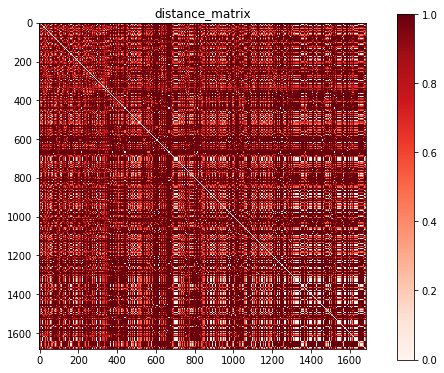

In [30]:
fig = plt.figure(figsize=(6, 6))

ax = fig.add_subplot(111)
ax.set_title('distance_matrix')
plt.imshow(distance_matrix,cmap='Reds')
ax.set_aspect('equal')

cax = fig.add_axes([0.3, 0.1, 0.78, 0.8])
cax.get_xaxis().set_visible(False)
cax.get_yaxis().set_visible(False)
cax.patch.set_alpha(0)
cax.set_frame_on(False)
plt.colorbar(orientation='vertical')
plt.show()